In [1]:
import pandas as pd 
import numpy as np
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from matplotlib import pyplot
import seaborn as sns
import matplotlib.pyplot as plt 
from sklearn import manifold

In [2]:
df = pd.read_csv('../Source/prepocessed_data.csv', sep= ',')
labels = pd.read_csv('../Source/labels.csv', sep= ',')

In [3]:
labels['genre'] = labels.genre.astype('category')
labels['genre'] = labels['genre'].cat.codes

In [4]:
pca = PCA(n_components=3)
df_pca = pca.fit_transform(df)

[0.3257296466894759, 0.1590007073022352, 0.10407972697534607, 0.08765788098876434, 0.07628551314011488, 0.06481005505698116, 0.05841376561227661, 0.040270362140947404, 0.030862897143730042, 0.023873321198739778, 0.019341777568278453, 0.009674346183110137]


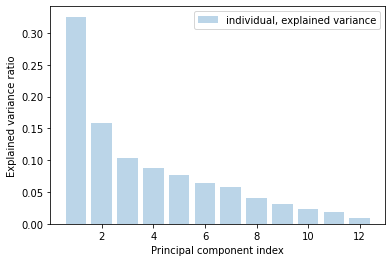

In [5]:
#Elbow plot

#df.to_numpy() Execute only once

cov_mat = np.cov(df.T)
EVal, EVec = np.linalg.eig(cov_mat)


# Calculate (sum of) explained variances
sum_EVal = sum(EVal)
var_exp = [(i / sum_EVal) for i in sorted(EVal, reverse=True)]
print(var_exp)
scurr = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]


# Plot explained variances
plt.bar(scurr, var_exp, alpha=0.3, 
        align='center', label='individual, explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.show()

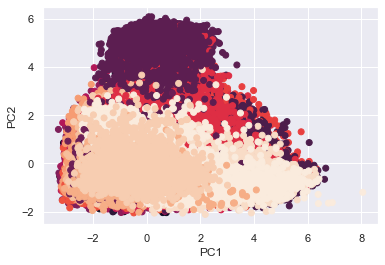

In [6]:
sns.set(style = "darkgrid")
fig = plt.figure()
ax = fig.add_subplot(111)
pca1 = [item[0] for item in df_pca]
pca2 = [item[1] for item in df_pca]


ax.set_xlabel("PC1")
ax.set_ylabel("PC2")

ax.scatter(pca1, pca2, c=labels['genre'])
plt.show()

In [11]:
tsne = manifold.TSNE(n_components=3, init='pca', random_state=0)
Y = tsne.fit_transform(df)

fig = plt.figure()
ax = fig.add_subplot(111, projection = '3d')
ax.scatter(Y[:, 0], Y[:, 1], Y[:, 2], c=labels, cmap=plt.cm.Spectral)

ax.axis('tight')
plt.show()